## Modula 2: Project King County House Sales

Please fill out:
* Student name: Nastaran Nazemian
* Student pace: part time
* Scheduled project review date/time: 06/23/2020 at 11:00 AM PST
* Instructor name: Eli Thomas
* Blog post URL:


# Table of Contents

1. [Introduction](#intro)

    1.1 [Column Names and Descriptions](#column)
    
    
2. [Methodology](#method)

    2.1 [Obtain](#obtain)
    
    2.2 [Scrubc](#scrub)
    * [Change the Data Type and Add Some Features](#type)
    * [Correct the Incorrect Values](#correct)
    * [Missing Data](#missing)
    
   2.3 [Explore](#explore)
   * [Correlation and Collinearity](#corr)
   * [Question1](#question1)
   * [Question2](#question2)
   * [Question3](#question3)
   * [Outliers](#outliers)
   
   2.4 [Model](#model)
   * [Data Normalization and Scaling ](#normalizing)
   * [Fitting Linear a Regression Model](#mdeling)
   * [Model Validation](#validation)
   * [Interpret the Results](#interpret)
3. [Recommendations](#recommendation)
4. [Future Work](#Futur)
   
   

# 1. Introduction:  <a class="anchor" id="intro"></a>
Recently, by growing technology companies in WA, buying a house is one of the most challenging tasks for people. There are many features which are directly or indirectly affect house prices. In this project, I am evaluating some of these features and their effects on sale prices during 2014 through 2015 in King County, Washington state, and create a model for predicting future prices.
I’ve used the data from Kaggle. There are over 21,000 records with 21 columns. Below, I briefly walk describe each column.
## 1.1 Column Names and descriptions for Kings County Data Set:<a class="anchor" id="column"></a>
* **id** - unique identified for a house
* **dateDate** - house was sold
* **pricePrice** -  is prediction target
* **bedroomsNumber** -  of Bedrooms/House
* **bathroomsNumber** -  of bathrooms/bedrooms
* **sqft_livingsquare** -  footage of the home
* **sqft_lotsquare** -  footage of the lot
* **floorsTotal** -  floors (levels) in house
* **waterfront** - House which has a view to a waterfront
* **view** - Has been viewed
* **condition** - How good the condition is ( Overall )
* **grade** - overall grade given to the housing unit, based on King County grading system
* **sqft_above** - square footage of house apart from basement
* **sqft_basement** - square footage of the basement
* **yr_built** - Built Year
* **yr_renovated** - Year when house was renovated
* **zipcode** - zip
* **lat** - Latitude coordinate
* **long** - Longitude coordinate
* **sqft_living15** - The square footage of interior housing living space for the nearest 15 neighbors
* **sqft_lot15** - The square footage of the land lots of the nearest 15 neighbors

# 2. Methodology: <a class="anchor" id="method"></a>
I’ve used the OSEMiN data science workflow, which involves:
* **Obtain** (import the data)
* **Scrub** (clean the data, deal with missing values and data types)
* **Explor** (answer descriptive questions using EDA)
* **Interpret** (comment on our model and findings)

## 2.1 Obtain: <a class="anchor" id="obtain"></a>
At first, importing necessary libraries. Then loading the data set.


In [1]:
import json
import pandas as pd
import numpy as np
import datetime
import calendar
import warnings
warnings.filterwarnings('ignore')
import math
import statistics as stat
import statsmodels.api as sm
from scipy.stats import norm
from scipy import stats
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import cross_val_score
from sklearn.linear_model import LinearRegression
linreg = LinearRegression()
from sklearn.preprocessing import PolynomialFeatures
import matplotlib.pyplot as plt
from matplotlib.ticker import FuncFormatter
import seaborn as sns
plt.style.use('seaborn')
sns.set(color_codes=True)
%matplotlib inline

In [2]:
data = pd.read_csv('kc_house_data.csv')
data.shape

(21597, 21)

In [3]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21597 entries, 0 to 21596
Data columns (total 21 columns):
id               21597 non-null int64
date             21597 non-null object
price            21597 non-null float64
bedrooms         21597 non-null int64
bathrooms        21597 non-null float64
sqft_living      21597 non-null int64
sqft_lot         21597 non-null int64
floors           21597 non-null float64
waterfront       19221 non-null float64
view             21534 non-null float64
condition        21597 non-null int64
grade            21597 non-null int64
sqft_above       21597 non-null int64
sqft_basement    21597 non-null object
yr_built         21597 non-null int64
yr_renovated     17755 non-null float64
zipcode          21597 non-null int64
lat              21597 non-null float64
long             21597 non-null float64
sqft_living15    21597 non-null int64
sqft_lot15       21597 non-null int64
dtypes: float64(8), int64(11), object(2)
memory usage: 3.5+ MB


## 2.2 Scrub:<a class="anchor" id="scrub"></a>
In the data scrubbing process, I first examined the data type of some columns, then discovered and corrected the incorrect data, and predicted the missing data. 

#### Change the data type and add some features: <a class="anchor" id="type"></a> 

In [4]:
data['date'] = data['date'].astype('datetime64[ns]')

data['year_sold'] = pd.DatetimeIndex(data['date']).year
data['month'] = pd.DatetimeIndex(data['date']).month
data['month_sold'] = data['month'].apply(lambda x: calendar.month_abbr[x])
#data['date'].isna().sum()

The data set include Built Year which didn’t give the that much information. By calculating the building age (subtract the built year from sold year), I was able to examine the effect of building age on price.

In [5]:
data['age']= data.year_sold - data.yr_built
data['age'] = data['age'].apply(lambda x: x if x > 0 else 0)

#### Correct the incorrect values:<a class="anchor" id="correct"></a>
In the sqft_basement column, some of the values are incorrect. They are ‘?’. Since our data set has number of the floors, square footage of house apart from basement ¬, and square footage of living area, I replace the ‘?’ mark with the difference of square footage living area and square footage above the basement, where the floor numbers is more than 1. Otherwise I put 0.

In [6]:
data.sqft_basement.unique()
for i, basement in enumerate(data.sqft_basement):
    if basement == '?' and (data.sqft_above[i] == data.sqft_living[i] or data.floors[i] ==1):
        data.sqft_basement[i] = 0
    else:
        data.sqft_basement[i] = data.sqft_living[i] - data.sqft_above[i]
data.sqft_basement.loc[data.sqft_basement == '?'].count()  

0

In [7]:
data['sqft_basement'] = data['sqft_basement'].astype(str).astype('float64')

#### Missing Data:<a class="anchor" id="missing"></a>
At first, trying to find the columns which has a missing data.

In [8]:
data.isna().sum()

id                  0
date                0
price               0
bedrooms            0
bathrooms           0
sqft_living         0
sqft_lot            0
floors              0
waterfront       2376
view               63
condition           0
grade               0
sqft_above          0
sqft_basement       0
yr_built            0
yr_renovated     3842
zipcode             0
lat                 0
long                0
sqft_living15       0
sqft_lot15          0
year_sold           0
month               0
month_sold          0
age                 0
dtype: int64

According to the results in above, there are three columns have a missing data. For calculating the missing values for view, I look at the 3 nearest neighbor’s house view and get the mean of them. So first, I defined a function which calculate the distance between two coordination. Then create a list of distance and sort it. Select 3 nearest neighbors and get the mean of the view. At the end I replace it with missing value.

In [9]:
import math
data['coordinates'] = list(zip(data.lat, data.long))
def distance(origin, destination):
    lat1, lon1 = origin
    lat2, lon2 = destination
    radius = 6371 # km

    dlat = math.radians(lat2-lat1)
    dlon = math.radians(lon2-lon1)
    a = math.sin(dlat/2) * math.sin(dlat/2) + math.cos(math.radians(lat1)) \
        * math.cos(math.radians(lat2)) * math.sin(dlon/2) * math.sin(dlon/2)
    c = 2 * math.atan2(math.sqrt(a), math.sqrt(1-a))
    d = radius * c

    return d


In [10]:
null_view = data.loc[data.view.isna()]
no_null_view = data.loc[~data.view.isna()]

for j in range(len(null_view)):
    nearest_neighbors = sorted(range(len(no_null_view)),\
                               key = lambda i: round(distance(null_view['coordinates'].iloc[j],\
                                              no_null_view['coordinates'].iloc[i]),3))[0:4]
    
    neighbor_view = []
    for i in nearest_neighbors:
        neighbor_view.append(data.view[i])
    data.view.iloc[null_view.index[j]] = math.ceil(stat.mean(neighbor_view ))

To estimate the waterfront missing values, I try to use the relation between of view and waterfront. 
As shown below 96.136% of the houses that don’t have view or good view, they aren’t waterfront too. Therefore, wherever the view is 0,1, or 2, with 96% probability, the house isn’t waterfront.For other missing values in waterfront columns, I use the same way that I used for views. 

In [11]:
data.groupby(['waterfront','view']).size()*100/ len(data)


waterfront  view
0.0         0.0     80.316711
            1.0      1.416863
            2.0      3.866278
            3.0      1.949345
            4.0      0.773256
1.0         0.0      0.004630
            1.0      0.004630
            2.0      0.032412
            3.0      0.064824
            4.0      0.569524
dtype: float64

Text(0.5, 1.0, 'Waterfront and View')

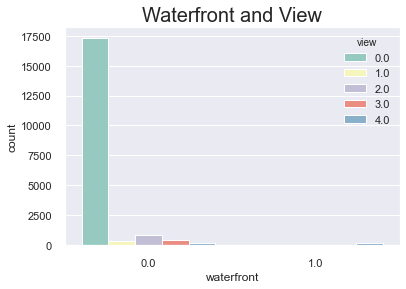

In [12]:
ax = sns.countplot(x="waterfront", hue="view",
                 data=data, dodge=True, palette="Set3")
plt.title('Waterfront and View', fontsize=20, ha='center')

In [13]:
for index in data.loc[data.waterfront.isna()].index:
    if data.view[index] == 0 or data.view[index] == 1 or data.view[index] == 2:
        data.waterfront[index] = 0

In [14]:
null_waterfront = data.loc[data.waterfront.isna()]
no_null_waterfront = data.loc[~data.waterfront.isna()]

for j in range(len(null_waterfront)):    
    near_neighbors = sorted(range(len(no_null_waterfront)),\
                               key = lambda i: round(distance(null_waterfront['coordinates'].iloc[j],\
                                              no_null_waterfront['coordinates'].iloc[i]),3))[0:4]    
    neighbor_waterfront = []   
    for i in near_neighbors:
        neighbor_waterfront.append(no_null_waterfront.waterfront.iloc[i])
    data.waterfront.loc[null_waterfront.index[j]] = math.ceil(stat.mean(neighbor_waterfront ))

In [15]:
for index in data.loc[data.yr_renovated.isna()].index:
    data.yr_renovated[index] = 0

## 2.3 Explore: <a class="anchor" id="explore"></a>
In this part, I am going to look at the relation between data, deal with outliers and normalize them. Pearson correlation is one of the tools to find the linear relationship between continues variable. 

#### Correlation and Collinearity:<a class="anchor" id="corr"></a>

In [16]:
cont_variables = data.loc[:, (data.nunique()>5)].columns.drop(['id','date','long','lat','zipcode','month'])
corr = round(data[cont_variables].corr(),2)
corr

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,grade,sqft_above,sqft_basement,yr_built,yr_renovated,sqft_living15,sqft_lot15,age
price,1.00,0.31,0.53,0.70,0.09,0.26,0.67,0.61,0.32,0.05,0.12,0.59,0.08,-0.05
bedrooms,0.31,1.00,0.51,0.58,0.03,0.18,0.36,0.48,0.30,0.16,0.02,0.39,0.03,-0.16
bathrooms,0.53,0.51,1.00,0.76,0.09,0.50,0.67,0.69,0.28,0.51,0.05,0.57,0.09,-0.51
sqft_living,0.70,0.58,0.76,1.00,0.17,0.35,0.76,0.88,0.43,0.32,0.05,0.76,0.18,-0.32
sqft_lot,0.09,0.03,0.09,0.17,1.00,-0.00,0.11,0.18,0.01,0.05,0.00,0.14,0.72,-0.05
floors,0.26,0.18,0.50,0.35,-0.00,1.00,0.46,0.52,-0.24,0.49,0.00,0.28,-0.01,-0.49
grade,0.67,0.36,0.67,0.76,0.11,0.46,1.00,0.76,0.17,0.45,0.02,0.71,0.12,-0.45
sqft_above,0.61,0.48,0.69,0.88,0.18,0.52,0.76,1.00,-0.05,0.42,0.02,0.73,0.20,-0.42
sqft_basement,0.32,0.30,0.28,0.43,0.01,-0.24,0.17,-0.05,1.00,-0.13,0.07,0.20,0.02,0.13
yr_built,0.05,0.16,0.51,0.32,0.05,0.49,0.45,0.42,-0.13,1.00,-0.20,0.33,0.07,-1.00


##### Table result:
* *There is a positive strong linear relationship between price and square footage living area. (70%)*
* *There is appositive good linear relationship between price and grade. (67%)*
* *There is appositive linear relationship between price and square footage of house apart from basement. (61%)*
* *There is appositive linear relationship between price and average square footage of living area. (59%)*
* *There is a collinearity between square footage of living area and bathrooms, grade, square footage of house apart from  basement, and average square footage of living area.*
 

In [17]:
abs(corr) > 0.70

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,grade,sqft_above,sqft_basement,yr_built,yr_renovated,sqft_living15,sqft_lot15,age
price,True,False,False,False,False,False,False,False,False,False,False,False,False,False
bedrooms,False,True,False,False,False,False,False,False,False,False,False,False,False,False
bathrooms,False,False,True,True,False,False,False,False,False,False,False,False,False,False
sqft_living,False,False,True,True,False,False,True,True,False,False,False,True,False,False
sqft_lot,False,False,False,False,True,False,False,False,False,False,False,False,True,False
floors,False,False,False,False,False,True,False,False,False,False,False,False,False,False
grade,False,False,False,True,False,False,True,True,False,False,False,True,False,False
sqft_above,False,False,False,True,False,False,True,True,False,False,False,True,False,False
sqft_basement,False,False,False,False,False,False,False,False,True,False,False,False,False,False
yr_built,False,False,False,False,False,False,False,False,False,True,False,False,False,True


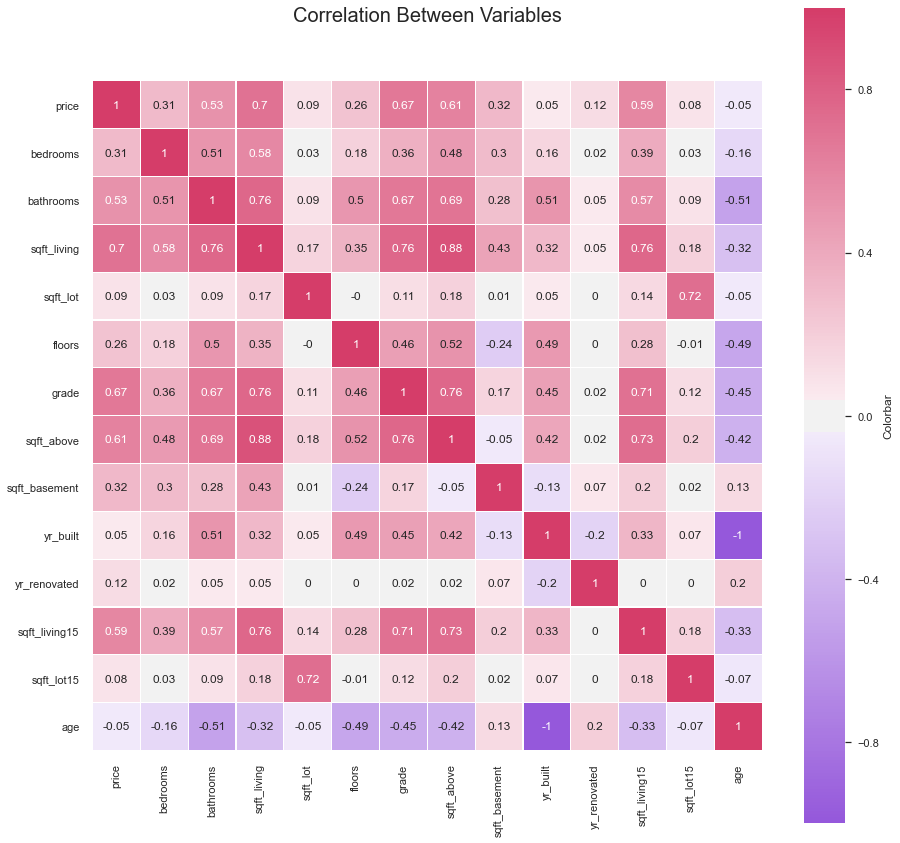

In [18]:
f, ax = plt.subplots(figsize=(15,15))
sns.set(font_scale=1)

cmap = sns.diverging_palette(1000, 0, as_cmap=True)
matrix = np.triu(corr)
mask = np.zeros_like(corr, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True
ax.set_title('Correlation Between Variables', y=1.2, fontsize=16, ha='center').set_position([0.5,1.08])
sns.heatmap(corr, cmap=cmap, vmax=1, center=0,
            square=True, linewidths=.2, ax=ax, annot=True,  
            cbar_kws={'label': 'Colorbar'})
plt.title('Correlation Between Variables', fontsize=20, ha='center')
plt.show()



#### Question1: What are the effects of the waterfront, view, condition and sold year on price? <a class="anchor" id="question1"></a>


In [19]:
variables = data.loc[:, (data.nunique()<6)].columns
len(variables )

4

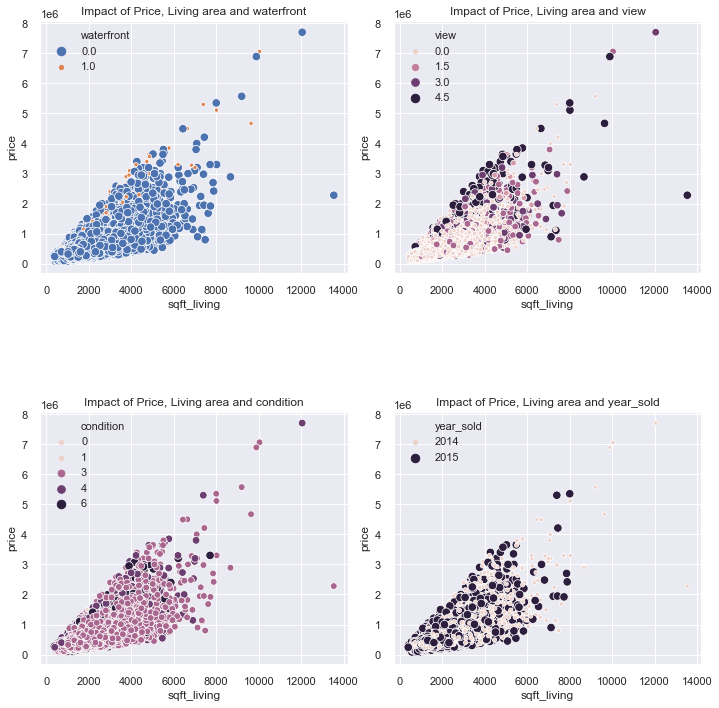

In [20]:
plt.figure(figsize=(10,10), facecolor='white')
plot_number = 1
for col in variables:
    ax = plt.subplot(2, 2, plot_number)
    sns.scatterplot(data.sqft_living, data.price, hue=data[col], size = data[col])
    ax.set_title('Impact of Price, Living area and {0}'.format(col))
    plot_number = plot_number + 1
plt.tight_layout()
plt.subplots_adjust(hspace=0.55)
plt.show()


In below briefly looking over the impact of waterfront, view, condition and sold year on price.

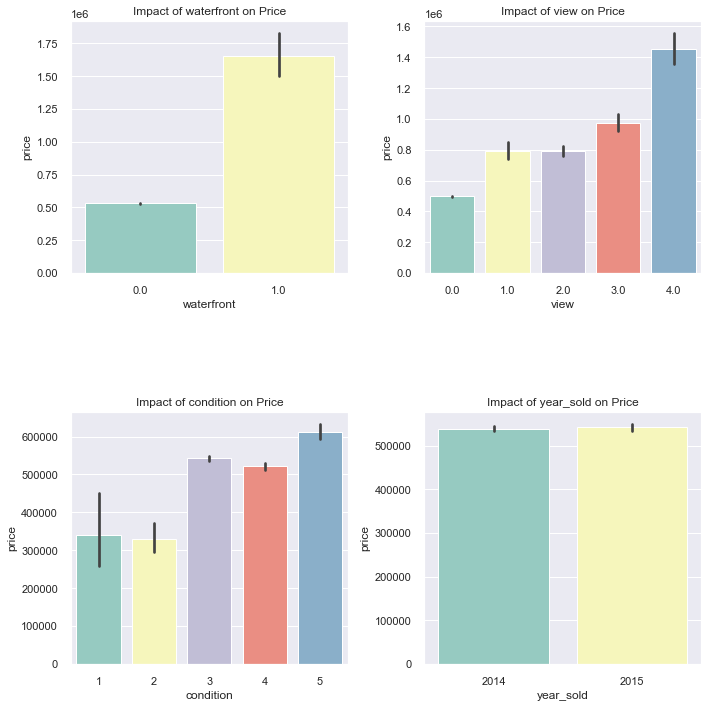

In [21]:
plt.figure(figsize=(10,10), facecolor='white')
plot_number = 1
for col in variables:
    ax = plt.subplot(2, 2, plot_number)
    sns.barplot(data[col], data.price, palette="Set3")
    ax.set_title('Impact of {0} on Price'.format(col))
    plot_number = plot_number + 1
plt.tight_layout()
plt.subplots_adjust(hspace=0.55)
plt.show()


Based on the charts, view and waterfront have impact on the price. Generally, by increasing the house price the condition gets better. And for sold year, passing the time can affect on price.

#### Question2: Which month is the best month for sales? <a class="anchor" id="question2"></a>
In this part, I look over the sells during  different months. 

In [22]:
data_sorted_by_date = data[['month_sold']].copy()
data_sorted_by_date['month_sold_dt'] = pd.to_datetime(data_sorted_by_date.month_sold, format='%b', errors='coerce').dt.month
data_sorted_by_date.sort_values(by='month_sold_dt',inplace=True)
#data_sorted_by_date.head()

<Figure size 1224x1224 with 0 Axes>

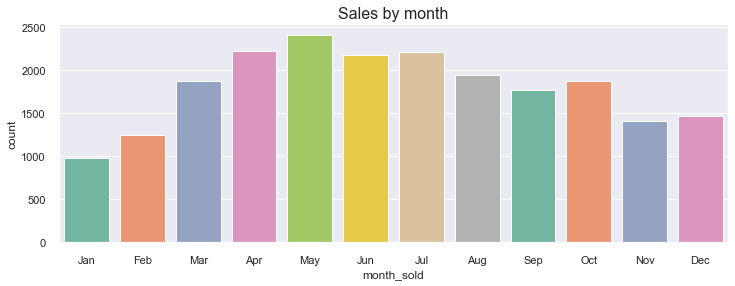

In [23]:
plt.figure(figsize=(17,17), facecolor='white')

# ax = plt.subplot(4, 2, plot_number)
# sns.barplot(data.month_sold, data.price)
# ax.set_title('Impact of Month on Price')
# data.head()
plt.figure(figsize=(12,4))
ax = sns.countplot(x="month_sold", data=data_sorted_by_date, palette="Set2")
plt.title('Sales by month', fontdict={'fontsize': 16})
plt.show()


 According to the plot the best time to selling house starts in March, peaks in May, and then declines.
 
 #### Question3: Visualize the density of sold houses in king county by city<a class="anchor" id="question3"></a>

In [24]:
zip_df = pd.read_csv('zipcode_kc_city.csv')
zip_df.head()
data = pd.merge(left=data, right=zip_df, how='left', left_on='zipcode', right_on='zipcode')
data = data.rename(columns={"City": "city"})
avg_housing_city = data.groupby(['city']).mean()
avg_housing_city =avg_housing_city.reset_index()

In [25]:
variables2 = data.loc[:, (data.nunique()>6)].drop(['id','date','long','lat','zipcode','coordinates', 'city','month','month_sold'],axis = 1).columns

In [26]:
import folium
from folium import plugins
from folium.plugins import MarkerCluster

length =len(data)
data.head(10)
m = folium.Map(location=[47.1559, -121.646], zoom_start=9,
               detect_retin=True, control_scal= False,tiles="http://tile.stamen.com/toner-lite/{z}/{x}/{y}.png",
               attr= 'Map tiles by <a href="http://stamen.com">Stamen Design</a>, <a href="http://creativecommons.org/licenses/by/3.0">CC BY 3.0</a> &mdash; Map data &copy; <a href="https://www.openstreetmap.org/copyright">OpenStreetMap</a> contributors',
               subdomains= 'abcd',minZoom= 0,maxZoom= 20,ext= 'png')
state_geo = f'https://opendata.arcgis.com/datasets/505628cf65964c3c87de6a05de367ab2_337.geojson'

folium.Choropleth(
    geo_data=state_geo,
    name='choropleth',
    data=avg_housing_city,
    columns=['city', 'price'],
    key_on='feature.properties.NAME',
    fill_color='YlGn',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='price Rate'
).add_to(m)
marker_cluster = MarkerCluster().add_to(m)

cluster = folium.plugins.MarkerCluster().add_to(m)
for i, row in data.iterrows():
    folium.Marker(location=[data['lat'][i], data['long'][i]],
                  popup="""
                   <i>sales Price: </i> <br> <b>${}</b> 
                   """.format(round(data['price'][i],2)),
                 tooltip="City: {}".format(data["city"][i])).add_to(cluster)

folium.LayerControl(collapsed=True).add_to(m)
m
#m.save('map.html')

Medina is the most expensive area in King County. Most of the sold houses are in Seattle area. South and North part of the County have the cheapest sold houses. The house price goes up in Clyde Hill, Bellevue, Eastgate, Mercer Island.  

#### Outliers:<a class="anchor" id="outliers"></a>
 In this section I try to find outliers and take them out.

In [27]:
variables2 = data.loc[:, (data.nunique()>6)].drop(['id','date','long','lat','zipcode','coordinates', 'month','month_sold', 'city'],axis = 1).columns

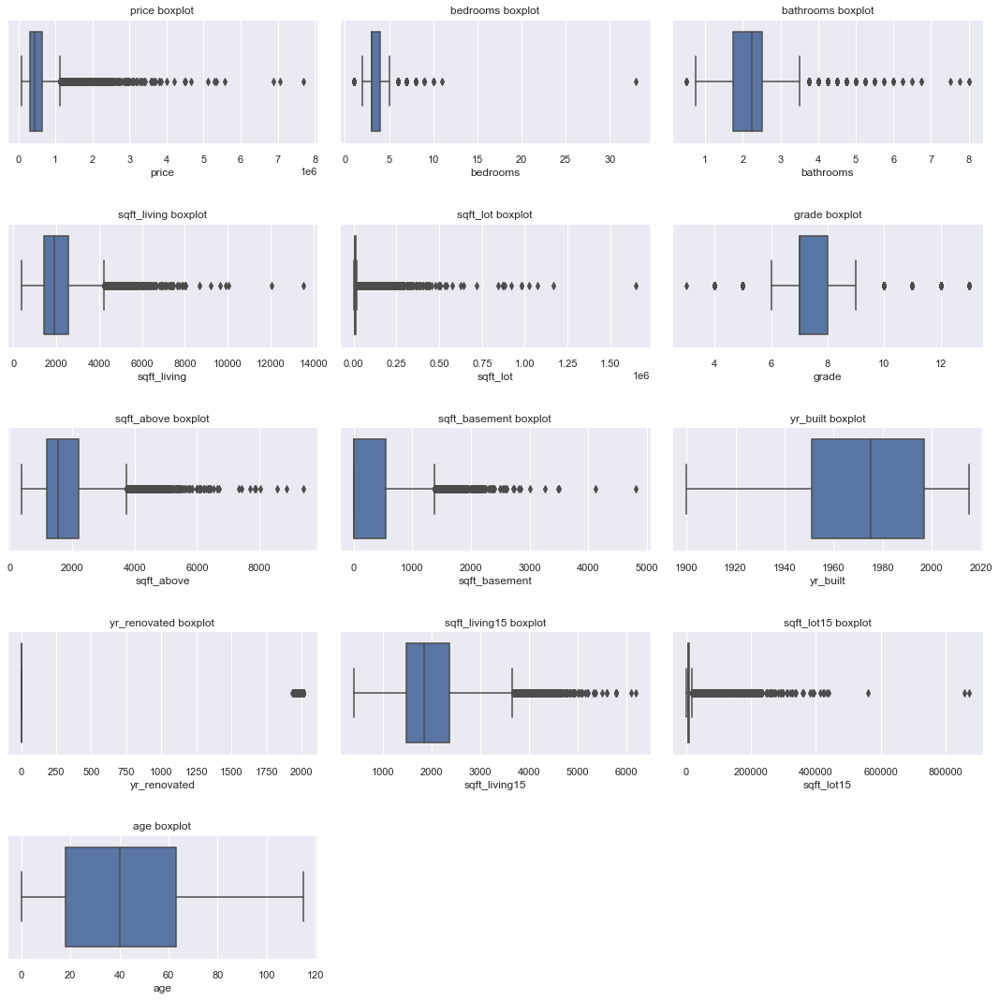

In [28]:
plt.figure(figsize=(15,15), facecolor='white')
plot_number = 1

for var in variables2:
    ax = plt.subplot(5, 3, plot_number)
    sns.boxplot(data[var])
    ax.set_title('{0} boxplot'.format(var))
    plot_number = plot_number + 1
plt.tight_layout()
plt.subplots_adjust(hspace=0.65)
plt.show()

In [29]:
data_no = data[data.price < 4000000]
data_no = data_no[data_no.sqft_living < 8000]
data_no = data_no[data_no.sqft_lot < 500000]
data_no = data_no[data_no.bedrooms < 5]
data_no = data_no[data_no.bathrooms < 4]

After removing the outliers, the distribution of the data as below

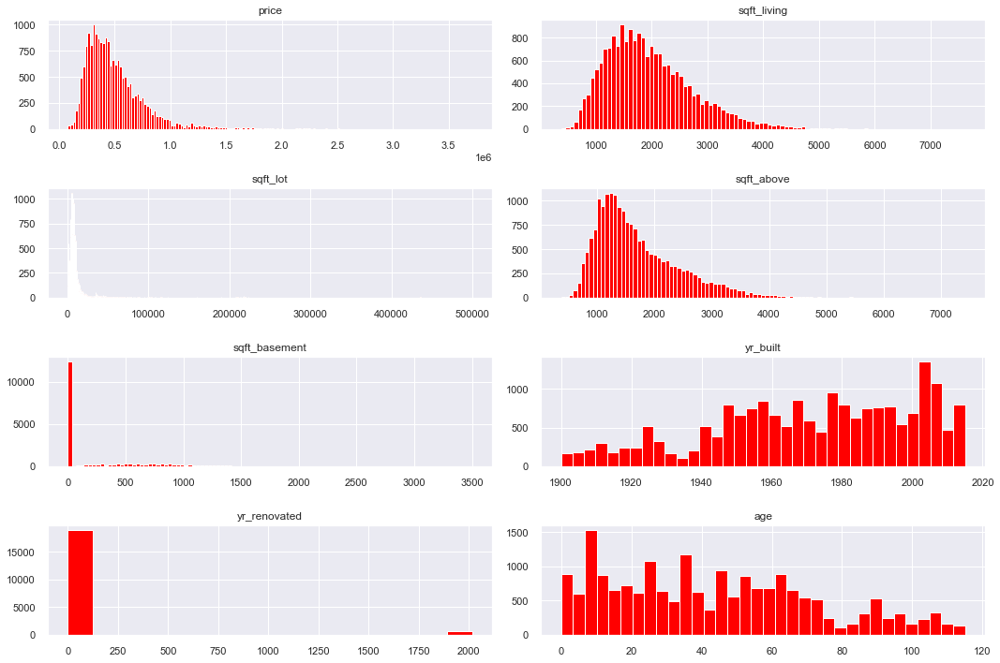

In [30]:
fig, axes = plt.subplots(nrows=4, ncols=2, figsize=(15,10))
cont_variables= data.loc[:, (data.nunique()>30)].\
                        drop(['id', 'date','zipcode','lat','long','sqft_living15',\
                              'sqft_lot15','coordinates','city'], axis =1).columns
for var, ax in zip(cont_variables, axes.flatten()):
    ax.hist(data_no[var], bins= 'auto', color='red')
    ax.set_title(var)
plt.subplots_adjust(hspace=0.75)       
fig.tight_layout()


## 2.4 Model: <a class="anchor" id="model"></a>
The process of creating a model for data is called data modeling.

#### Data Normalization and Scaling : <a class="anchor" id="normalizing"></a>

In [31]:
data_no['sqft_basement'] = data_no['sqft_basement'].astype(str).astype('float64')

In [32]:
variables3=['price', 'sqft_living', 'sqft_lot', 'sqft_above', 'sqft_basement','age']

for var in variables3:
    name = 'log_' + var
#print(name, var)
    data_no[name] = np.log(data_no[var], where=(data_no[var] > 0))
# df.info()

In [33]:
variables4=['log_price', 'log_sqft_living', 'log_sqft_lot', 'log_sqft_above', 'log_sqft_basement','log_age']
for var in variables4:
    name = 'norm_' + var
#print(name, var)
    data_no[name] = (data_no[var]-min(data_no[var])/(max(data_no[var]-min(data_no[var]))))

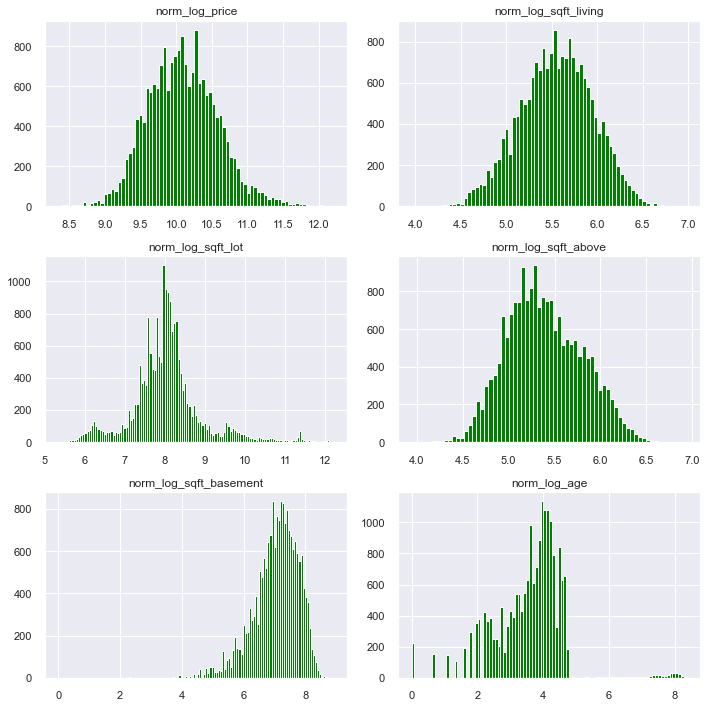

In [34]:
variables5=['norm_log_price', 'norm_log_sqft_living', 'norm_log_sqft_lot',\
                 'norm_log_sqft_above', 'norm_log_sqft_basement','norm_log_age']
fig, axes = plt.subplots(nrows=3, ncols=2, figsize=(10,10))
for var, ax in zip(variables5, axes.flatten()):
    ax.hist(data_no[var], bins= 'auto', color='green')
    ax.set_title(var)
plt.subplots_adjust(hspace=0.75)       
fig.tight_layout()

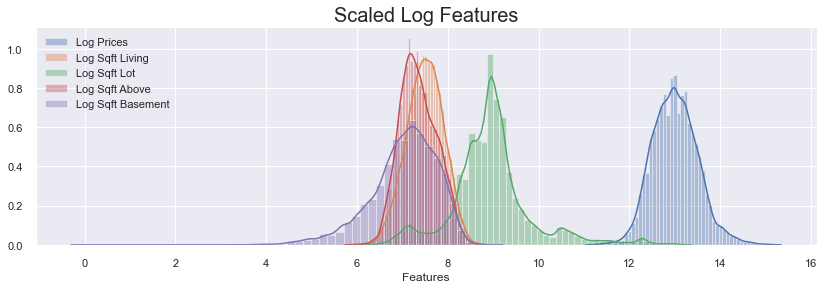

In [35]:
plt.figure(figsize=(14,4))
sns.distplot(data_no.log_price, label='Log Prices')
sns.distplot(data_no.log_sqft_living, label='Log Sqft Living')
sns.distplot(data_no.log_sqft_lot, label='Log Sqft Lot')
sns.distplot(data_no.log_sqft_above, label='Log Sqft Above')
sns.distplot(data_no.log_sqft_basement, label='Log Sqft Basement')

plt.title('Scaled Log Features', fontdict={'fontsize': 20})
plt.xlabel('Features')
plt.legend()
plt.show()

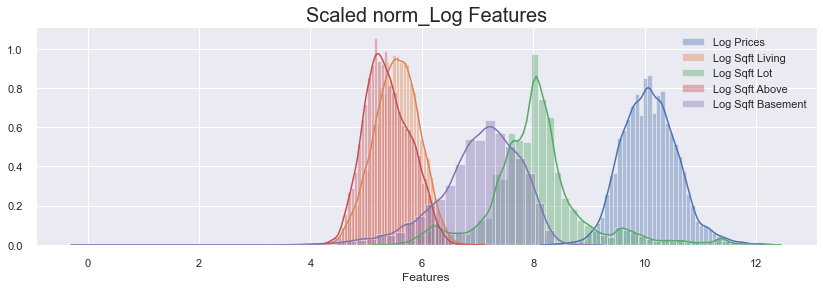

In [36]:
plt.figure(figsize=(14,4))
sns.distplot(data_no.norm_log_price, label='Log Prices')
sns.distplot(data_no.norm_log_sqft_living, label='Log Sqft Living')
sns.distplot(data_no.norm_log_sqft_lot, label='Log Sqft Lot')
sns.distplot(data_no.norm_log_sqft_above, label='Log Sqft Above')
sns.distplot(data_no.norm_log_sqft_basement, label='Log Sqft Basement')

plt.title('Scaled norm_Log Features', fontdict={'fontsize': 20})
plt.xlabel('Features')
plt.legend()
plt.show()

In [37]:
data_no['has_basement'] = data_no['sqft_basement'].apply(lambda x: 1 if x > 0 else 0)
data_no[['sqft_basement','has_basement']][:5]

,sqft_basement,has_basement
0,0.0,0
1,400.0,1
2,0.0,0
3,910.0,1
4,0.0,0


In [38]:
data_no['is_renovated'] = data_no['yr_renovated'].apply(lambda x: 1 if x > 0 else 0)

In [39]:
data_reg = data_no 
data_reg.waterfront = data_no.waterfront.astype('category')
data_reg.view = data_no.view.astype('category')
data_reg.condition = data_no.condition.astype('category')
data_reg.zipcode = data_no.zipcode.astype('category')
data_reg.yr_built = data_no.yr_built.astype('category')
data_reg.has_basement = data_no.has_basement.astype('category')
data_reg.is_renovated = data_no.is_renovated.astype('category')
data_reg.city = data_no.city.astype('category')

#### Fitting Linear a Regression Model:  <a class="anchor" id="modeling"></a>
To find the right model, I first enter all the variables that have a linear relationship with the price and then evaluate the linear model and check the R-squared.

In [40]:
model1 = data_reg[['norm_log_sqft_living','norm_log_price','bedrooms','bathrooms','view','grade']].copy()

view = pd.get_dummies(model1.view, prefix='view', drop_first=True)
model1= model1.join([view])
model1.drop(['view'], axis=1, inplace= True)

X = model1.drop('norm_log_price', axis =1)
y = model1.norm_log_price

X = X.astype(float)
#data_reg_drop.rename(columns={ "view_1.0":"view_1", 'view_2.0':"view_2", "view_3.0":"view_3","view_4.0":"view_4",inplace = True)
X.rename(columns={"view_1.0":"view_1", 'view_2.0':"view_2", "view_3.0":"view_3","view_4.0":"view_4"},inplace = True)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33)
linreg.fit(X_train, y_train)
y_hat_train = linreg.predict(X_train)
y_hat_test = linreg.predict(X_test)

predictors_int = sm.add_constant(X_train)
model = sm.OLS(y_train,predictors_int).fit()
model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:         norm_log_price   R-squared:                       0.542
Model:                            OLS   Adj. R-squared:                  0.542
Method:                 Least Squares   F-statistic:                     1928.
Date:                Tue, 23 Jun 2020   Prob (F-statistic):               0.00
Time:                        09:40:40   Log-Likelihood:                -4336.9
No. Observations:               13044   AIC:                             8692.
Df Residuals:                   13035   BIC:                             8759.
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
========================================================================================
                           coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                    6.2256      0.055    112.710      0.000       6.117       6.334
norm_log_sqft_living     0.4835      0.014     33.941      0.000       0.456       0.511
bedrooms                -0.0617      0.006    -11.206      0.000      -0.073      -0.051
bathrooms               -0.0199      0.007     -3.015      0.003      -0.033      -0.007
grade                    0.1839      0.004     44.977      0.000       0.176       0.192
view_1                   0.2712      0.024     11.266      0.000       0.224       0.318
view_2                   0.1999      0.015     13.252      0.000       0.170       0.230
view_3                   0.2446      0.021     11.781      0.000       0.204       0.285
view_4                   0.5380      0.027     19.717      0.000       0.485       0.592
==============================================================================
Omnibus:                       28.256   Durbin-Watson:                   2.014
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               25.001
Skew:                           0.061   Prob(JB):                     3.72e-06
Kurtosis:                       2.823   Cond. No.                         198.
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In this mode the R-squared is 0.526 which means 53% of the response variable variation that is explained by a linear model, while all the independent variables are significant.

In [41]:
# waterfront = pd.get_dummies(data_reg.waterfront, prefix='waterfront', drop_first=True)
# view = pd.get_dummies(data_reg.view, prefix='view', drop_first=True)
# condition = pd.get_dummies(data_reg.condition, prefix='condition', drop_first=True)
# grade = pd.get_dummies(data_reg.grade, prefix='grade', drop_first=True)
# zipcode = pd.get_dummies(data_reg.zipcode, prefix='zipcode', drop_first=True)
# bedrooms = pd.get_dummies(data_reg.bedrooms, prefix='bedrooms', drop_first=True)
# floors = pd.get_dummies(data_reg.floors, prefix='floors', drop_first=True)
# bathrooms = pd.get_dummies(data_reg.bathrooms, prefix='bathrooms', drop_first=True)
# #yr_built = pd.get_dummies(data_reg.yr_built, prefix='yr_built', drop_first=True)

In [42]:
# predictors_int = sm.add_constant(X_train)
# model2_train = sm.OLS(y_train, predictors_int).fit()
# predictors_int = sm.add_constant(X_test)
# model2_test = sm.OLS(y_test,predictors_int).fit()

# print('R2: ', model2_test.rsquared)
# print('Mean Standard errors train: ', model2_test.bse.mean())
# print('R2: ', model2_train.rsquared)
# print('Mean Standard errors test: ', model2_train.bse.mean())

In [43]:
#model = LinearRegression()
# linreg_1 = LinearRegression()
# cv_10_results = np.mean(cross_val_score(linreg_1, X_train, y_train, cv=10, scoring="r2"))
# cv_10_results

For second model I add the condition to the model.

In [44]:
model2 = data_reg[['norm_log_sqft_living','norm_log_price','bedrooms','view','condition','grade']].copy()
model2.head()
view = pd.get_dummies(model2.view, prefix='view', drop_first=True)
condition = pd.get_dummies(model2.condition, prefix='condition', drop_first=True)

model2= model2.join([view, condition])
model2.drop(['view','condition'], axis=1, inplace= True)
X = model2.drop('norm_log_price', axis =1)
y = model2.norm_log_price
X = X.astype(float)
X.rename(columns={"view_1.0":"view_1", 'view_2.0':"view_2", "view_3.0":"view_3","view_4.0":"view_4"},inplace = True)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33)
linreg.fit(X_train, y_train)
y_hat_train = linreg.predict(X_train)
y_hat_test = linreg.predict(X_test)
import statsmodels.api as sm
predictors_int = sm.add_constant(X_train)
model = sm.OLS(y_train,predictors_int).fit()
model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:         norm_log_price   R-squared:                       0.553
Model:                            OLS   Adj. R-squared:                  0.552
Method:                 Least Squares   F-statistic:                     1465.
Date:                Tue, 23 Jun 2020   Prob (F-statistic):               0.00
Time:                        09:40:40   Log-Likelihood:                -4275.3
No. Observations:               13044   AIC:                             8575.
Df Residuals:                   13032   BIC:                             8664.
Df Model:                          11                                         
Covariance Type:            nonrobust                                         
========================================================================================
                           coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                    6.2247      0.088     70.979      0.000       6.053       6.397
norm_log_sqft_living     0.4323      0.013     33.451      0.000       0.407       0.458
bedrooms                -0.0635      0.005    -11.706      0.000      -0.074      -0.053
grade                    0.1975      0.004     49.584      0.000       0.190       0.205
view_1                   0.2386      0.024     10.097      0.000       0.192       0.285
view_2                   0.1852      0.015     12.320      0.000       0.156       0.215
view_3                   0.2418      0.021     11.708      0.000       0.201       0.282
view_4                   0.4615      0.026     17.480      0.000       0.410       0.513
condition_2              0.0294      0.082      0.360      0.719      -0.131       0.190
condition_3              0.1140      0.075      1.512      0.131      -0.034       0.262
condition_4              0.1901      0.075      2.519      0.012       0.042       0.338
condition_5              0.3350      0.076      4.406      0.000       0.186       0.484
==============================================================================
Omnibus:                        4.402   Durbin-Watson:                   1.994
Prob(Omnibus):                  0.111   Jarque-Bera (JB):                4.425
Skew:                           0.041   Prob(JB):                        0.109
Kurtosis:                       2.961   Cond. No.                         581.
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

According to the table above, R-squared didn’t increases that much. The condition variable is not significant at most levels

In [45]:
# predictors_int = sm.add_constant(X_train)
# model2_train = sm.OLS(y_train, predictors_int).fit()
# predictors_int = sm.add_constant(X_test)
# model2_test = sm.OLS(y_test,predictors_int).fit()

# print('R2: ', model2_test.rsquared)
# print('Mean Standard errors train: ', model2_test.bse.mean())
# print('R2: ', model2_train.rsquared)
# print('Mean Standard errors test: ', model2_train.bse.mean())

In [46]:
# linreg_2 = LinearRegression()
# cv_10_results = np.mean(cross_val_score(linreg_2, X_train, y_train, cv=10, scoring="r2"))
# cv_10_results

In this model, I add the zip code variable to the model as a categorical variable.

In [47]:
model3 = data_reg[['norm_log_sqft_living','norm_log_price','view','bedrooms','zipcode','grade']].copy()
model3.head()

view = pd.get_dummies(model3.view, prefix='view', drop_first=True)
zipcode = pd.get_dummies(model3.zipcode, prefix='zipcode', drop_first=True)


model3= model3.join([view,zipcode])
model3.drop(['view','zipcode'], axis=1, inplace= True)

X = model3.drop('norm_log_price', axis =1)
X = X.astype(float)
X.rename(columns={"view_1.0":"view_1", 'view_2.0':"view_2", "view_3.0":"view_3","view_4.0":"view_4"},inplace = True)
y = model3.norm_log_price
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33)
linreg.fit(X_train, y_train)
y_hat_train = linreg.predict(X_train)
y_hat_test = linreg.predict(X_test)

import statsmodels.api as sm
predictors_int = sm.add_constant(X_train)
model = sm.OLS(y_train,predictors_int).fit()
model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:         norm_log_price   R-squared:                       0.848
Model:                            OLS   Adj. R-squared:                  0.847
Method:                 Least Squares   F-statistic:                     950.7
Date:                Tue, 23 Jun 2020   Prob (F-statistic):               0.00
Time:                        09:40:41   Log-Likelihood:                 2917.8
No. Observations:               13044   AIC:                            -5682.
Df Residuals:                   12967   BIC:                            -5106.
Df Model:                          76                                         
Covariance Type:            nonrobust                                         
========================================================================================
                           coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                    6.0665      0.032    189.770      0.000       6.004       6.129
norm_log_sqft_living     0.5177      0.008     67.353      0.000       0.503       0.533
bedrooms                -0.0124      0.003     -3.886      0.000      -0.019      -0.006
grade                    0.0940      0.002     38.850      0.000       0.089       0.099
view_1                   0.1512      0.014     10.714      0.000       0.124       0.179
view_2                   0.1437      0.009     16.107      0.000       0.126       0.161
view_3                   0.2137      0.013     16.646      0.000       0.189       0.239
view_4                   0.5052      0.016     32.170      0.000       0.474       0.536
zipcode_98002           -0.0230      0.022     -1.035      0.301      -0.066       0.021
zipcode_98003           -0.0019      0.019     -0.097      0.923      -0.040       0.036
zipcode_98004            1.1519      0.020     56.318      0.000       1.112       1.192
zipcode_98005            0.8032      0.024     33.237      0.000       0.756       0.851
zipcode_98006            0.6713      0.017     39.088      0.000       0.638       0.705
zipcode_98007            0.6664      0.027     24.809      0.000       0.614       0.719
zipcode_98008            0.6602      0.020     33.566      0.000       0.622       0.699
zipcode_98010            0.3498      0.027     12.879      0.000       0.297       0.403
zipcode_98011            0.4241      0.023     18.588      0.000       0.379       0.469
zipcode_98014            0.3518      0.025     14.276      0.000       0.303       0.400
zipcode_98019            0.2994      0.022     13.422      0.000       0.256       0.343
zipcode_98022            0.0921      0.021      4.383      0.000       0.051       0.133
zipcode_98023           -0.0337      0.017     -2.036      0.042      -0.066      -0.001
zipcode_98024            0.4676      0.031     15.230      0.000       0.407       0.528
zipcode_98027            0.5314      0.018     30.002      0.000       0.497       0.566
zipcode_98028            0.3969      0.020     20.260      0.000       0.358       0.435
zipcode_98029            0.5819      0.019     31.240      0.000       0.545       0.618
zipcode_98030            0.0298      0.020      1.463      0.144      -0.010       0.070
zipcode_98031            0.0771      0.019      3.971      0.000       0.039       0.115
zipcode_98032           -0.0211      0.026     -0.824      0.410      -0.071       0.029
zipcode_98033            0.7881      0.017     45.060      0.000       0.754       0.822
zipcode_98034            0.5356      0.016     32.793      0.000       0.504       0.568
zipcode_98038            0.1632      0.016     10.232      0.000       0.132       0.194
zipcode_98039            1.3929      0.046     30.016    

R-squared significantly increased by adding zip code. The zip code variable is significant at most levels. In the next step, I will evaluate the model. 


#### Model Validation:<a class="anchor" id="validation"></a>

In [48]:
predictors_int = sm.add_constant(X_train)
model3_train = sm.OLS(y_train, predictors_int).fit()
predictors_int = sm.add_constant(X_test)
model3_test = sm.OLS(y_test,predictors_int).fit()

print('R2: ', model3_test.rsquared)
print('Mean Standard errors train: ', model3_test.bse.mean())
print('R2: ', model3_train.rsquared)
print('Mean Standard errors test: ', model3_train.bse.mean())

R2:  0.8573639086461852
Mean Standard errors train:  0.027917991944419688
R2:  0.8478404992324041
Mean Standard errors test:  0.019820690869692834


In [49]:
linreg_3 = LinearRegression()
cv_10_results = np.mean(cross_val_score(linreg_3, X_train, y_train, cv=10, scoring="r2"))
cv_10_results

0.845375400677684

Since some levels of zip code do not significant, in this section I will remove those levels and then re-evaluate the model.

In [50]:
p_values =round(model.summary2().tables[1]['P>|t|'],4)
var_high_p_value=[]

for i, p_value in enumerate(p_values):
    if p_value >0.05:
        var_high_p_value.append(model.summary2().tables[1].index[i])
var_high_p_value

['zipcode_98002',
 'zipcode_98003',
 'zipcode_98030',
 'zipcode_98032',
 'zipcode_98092']

In [51]:
model4 = model3.drop(var_high_p_value,axis = 1).copy()
model4.head()
X = model4.drop('norm_log_price', axis =1)
X = X.astype(float)
X.rename(columns={"view_1.0":"view_1", 'view_2.0':"view_2", "view_3.0":"view_3","view_4.0":"view_4"},inplace = True)
X.head()
y = model4.norm_log_price
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33)
linreg.fit(X_train, y_train)
y_hat_train = linreg.predict(X_train)
y_hat_test = linreg.predict(X_test)

import statsmodels.api as sm
predictors_int = sm.add_constant(X_train)
model = sm.OLS(y_train,predictors_int).fit()
model.summary()


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:         norm_log_price   R-squared:                       0.851
Model:                            OLS   Adj. R-squared:                  0.851
Method:                 Least Squares   F-statistic:                     1047.
Date:                Tue, 23 Jun 2020   Prob (F-statistic):               0.00
Time:                        09:40:43   Log-Likelihood:                 2937.7
No. Observations:               13044   AIC:                            -5731.
Df Residuals:                   12972   BIC:                            -5193.
Df Model:                          71                                         
Covariance Type:            nonrobust                                         
========================================================================================
                           coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                    6.0729      0.030    203.860      0.000       6.014       6.131
norm_log_sqft_living     0.5120      0.008     66.841      0.000       0.497       0.527
bedrooms                -0.0097      0.003     -3.025      0.002      -0.016      -0.003
grade                    0.0967      0.002     40.260      0.000       0.092       0.101
view_1                   0.1390      0.014      9.909      0.000       0.112       0.167
view_2                   0.1513      0.009     16.997      0.000       0.134       0.169
view_3                   0.2453      0.012     19.826      0.000       0.221       0.270
view_4                   0.5402      0.015     34.911      0.000       0.510       0.571
zipcode_98004            1.1489      0.017     69.518      0.000       1.116       1.181
zipcode_98005            0.7930      0.021     37.437      0.000       0.751       0.835
zipcode_98006            0.6574      0.013     49.145      0.000       0.631       0.684
zipcode_98007            0.6366      0.022     28.376      0.000       0.593       0.681
zipcode_98008            0.6463      0.016     39.486      0.000       0.614       0.678
zipcode_98010            0.3187      0.024     13.468      0.000       0.272       0.365
zipcode_98011            0.4296      0.019     22.384      0.000       0.392       0.467
zipcode_98014            0.3191      0.022     14.703      0.000       0.277       0.362
zipcode_98019            0.3318      0.019     17.619      0.000       0.295       0.369
zipcode_98022            0.0850      0.016      5.188      0.000       0.053       0.117
zipcode_98023           -0.0359      0.012     -2.896      0.004      -0.060      -0.012
zipcode_98024            0.4733      0.032     14.954      0.000       0.411       0.535
zipcode_98027            0.5320      0.014     37.154      0.000       0.504       0.560
zipcode_98028            0.4046      0.016     25.185      0.000       0.373       0.436
zipcode_98029            0.5760      0.015     38.130      0.000       0.546       0.606
zipcode_98031            0.0649      0.016      3.993      0.000       0.033       0.097
zipcode_98033            0.7865      0.014     56.507      0.000       0.759       0.814
zipcode_98034            0.5239      0.012     42.503      0.000       0.500       0.548
zipcode_98038            0.1585      0.012     13.300      0.000       0.135       0.182
zipcode_98039            1.3196      0.041     32.180      0.000       1.239       1.400
zipcode_98040            0.9183      0.018     51.095      0.000       0.883       0.954
zipcode_98042            0.0672      0.012      5.446      0.000       0.043       0.091
zipcode_98045            0.3351      0.017     19.246      0.000       0.301       0.369
zipcode_98052            0.6330      0.013     50.168    

In [52]:
predictors_int = sm.add_constant(X_train)
model4_train = sm.OLS(y_train, predictors_int).fit()
predictors_int = sm.add_constant(X_test)
model4_test = sm.OLS(y_test,predictors_int).fit()

print('R2: ', model4_test.rsquared)
print('Mean Standard errors train: ', model4_test.bse.mean())
print('R2: ', model4_train.rsquared)
print('Mean Standard errors test: ', model4_train.bse.mean())

R2:  0.8486451246947878
Mean Standard errors train:  0.02379671265821123
R2:  0.8513757021419415
Mean Standard errors test:  0.01651815012895809


In [53]:
linreg_4 = LinearRegression()
cv_10_results = np.mean(cross_val_score(linreg_4, X_train, y_train, cv=10, scoring="r2"))
cv_10_results

0.849236067722817

#### Interpreting the Results:  <a class="anchor" id="interpreting"></a>


The first table evaluates the rejecte or not the linear relationship between the dependent variables and the response variable.
Given the P_value and the statistic F, present that there is no reason to accept the null hypothesis. Therefore, there is a linear relationship between the variables.
R-square 0.85, which means that 85% of model is explained by independent variables. And R_square tends to increase as you include additional predictors in the model. Thus, one can artificially get higher R square by increasing the number of Xs in the model. To control this effect, adjusted R square is used. When R_square and adjusted R are almost the same, it means that model has a good quality. 

In the second table, the meaning of each of the independent variables is evaluated and all the variables are meaningful. 
Square footage living significantly positively correlated with price.
* Bedrooms are significantly negatively correlated with price.
* Grade are significantly positively correlated with price.
* All the levels of the view are significantly positively correlated with price.
* All the levels of the zip code are significantly positively correlated with price.


# 3. Recommendations:  <a class="anchor" id="recommendation"></a>
According to the information obtained in this project, the district and the city have a significant role in the house price. As mentioned, sold houses in the northern and southern regions in 2015 and 2014 were cheaper than the sold houses in eastern or even Seattle.
The largest number of sold homes was in Seattle. Another factor influencing house prices is the square footage of living area of the house. And view is the third most influential factor in a home price.
The month of buying a house have an effective role in the price of a house. The best time to buy a home is from the beginning of September to the end of January.


# 4.Future Work:<a class="anchor" id="future"></a>
There are other factors that can affect the price of a home. These factors include the impact of inflation, commute, school, job opportunities in the area, and more. Examining each of these factors can play an important role in predicting housing prices.